In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler



# Import Data

In [2]:
data = pd.read_csv('../DataOut/bus_trip_speed_and_other_features.csv')
# import bus trips
bus_trips = pd.read_csv("../DataOut/bus_trips.csv")

# load the csv Data Sets\route points.csv 
route_points = pd.read_csv("../Data Sets/route points.csv")

In [3]:
data

,deviceid,devicetime,latitude,longitude,speed,date,time,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,time_diff,acc_diff,acceleration_der,segment
0,116,2021-10-16 08:03:19,7.293068,80.636430,14.03890,2021-10-16,08:03:19,0,2.0,1,0.323975,0.000000,0.000000,NaN,NaN,0.000000,1
1,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,0,2.0,1,-0.251980,1.278067,123.738485,0 days 00:00:15,-0.575955,-0.038397,1
2,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,0,2.0,1,-0.179987,0.722300,163.044397,0 days 00:00:15,0.071993,0.004800,1
3,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,0,2.0,1,-0.251980,0.048332,211.472339,0 days 00:00:15,-0.071993,-0.004800,1
4,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,101,2.0,1,0.359971,1.052222,287.492821,0 days 00:00:15,0.611951,0.040797,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4034419,1719,2022-02-25 16:47:53,7.291572,80.635452,2.15983,2022-02-25,16:47:53,0,15890.0,2,0.215983,0.714925,16242.694984,0 days 00:00:10,2.105833,0.210583,0
4034420,1719,2022-02-25 16:47:57,7.291587,80.635355,2.15983,2022-02-25,16:47:57,0,15890.0,2,0.000000,0.003500,16253.479312,0 days 00:00:04,-0.215983,-0.053996,0
4034421,1719,2022-02-25 16:48:02,7.291597,80.635293,3.77970,2022-02-25,16:48:02,0,15890.0,2,0.323974,1.320196,16260.374802,0 days 00:00:05,0.323974,0.064795,0
4034422,1719,2022-02-25 16:48:03,7.291605,80.635280,3.77970,2022-02-25,16:48:03,0,15890.0,2,0.000000,0.128080,16262.113859,0 days 00:00:01,-0.323974,-0.323974,0


In [4]:
# data with trip id 5672 
data[data['trip_id'] == 5672]

,deviceid,devicetime,latitude,longitude,speed,date,time,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,time_diff,acc_diff,acceleration_der,segment


In [5]:
# detects trips with not enought gps points and removes them
data['count'] = data.groupby('trip_id')['trip_id'].transform('count')
print(data['count'].mean())

# print a complete list of trip ids that count less than 50
print(data[data['count'] < 50]['trip_id'].unique())
# drop trips with less than 50 gps points
data = data[data['count'] > 50].copy()

607.25928856263
[]


## prepare data

In [6]:
#  date is do we will not include testing data in the clustering
datain_one_direction=data[(data['direction']==1) ]
data_to_cluster=datain_one_direction[['trip_id','deviceid','segment','speed','acceleration','radial_acceleration','acceleration_der']]
# reset index
data_to_cluster=data_to_cluster.reset_index(drop=True)

In [7]:
data_to_cluster

,trip_id,deviceid,segment,speed,acceleration,radial_acceleration,acceleration_der
0,2.0,116,1,14.03890,0.323975,0.000000,0.000000
1,2.0,116,1,10.25920,-0.251980,1.278067,-0.038397
2,2.0,116,1,7.55940,-0.179987,0.722300,0.004800
3,2.0,116,1,3.77970,-0.251980,0.048332,-0.004800
4,2.0,116,1,9.17927,0.359971,1.052222,0.040797
...,...,...,...,...,...,...,...
2054464,15891.0,1719,15,8.63931,0.269980,0.644606,-0.674945
2054465,15891.0,1719,0,10.79910,1.079895,1.726371,0.404957
2054466,15891.0,1719,0,10.79910,0.000000,1.702789,-0.539947
2054467,15891.0,1719,0,12.41900,0.809950,2.357947,0.404975


In [8]:
# set Nan in bus_stop to 0
data['bus_stop']=data['bus_stop'].fillna(0)
datain_one_direction['bus_stop']=datain_one_direction['bus_stop'].fillna(0)

C:\Users\gw\AppData\Local\Temp\ipykernel_39440\65654468.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  datain_one_direction['bus_stop']=datain_one_direction['bus_stop'].fillna(0)


In [9]:
Cols_for_clusteringDF=['devicetime', 'radial_acceleration','speed', 'acceleration','distance_from_start','acceleration_der','bus_stop']

In [10]:
from sklearn.preprocessing import StandardScaler

# Create empty lists to store trip IDs and dataframes
processed_trip_ids = []
dataframes_without_trip_id = []

# Iterate through each unique trip_id
for trip_id in datain_one_direction['trip_id'].unique():
    # Filter the data for the current trip_id
    trip_data = datain_one_direction[datain_one_direction['trip_id'] == trip_id].copy()
    
    # Remove the trip_id column from the current trip_data
    trip_data_without_id = trip_data[Cols_for_clusteringDF]
    
    # Ensure selected columns are numeric (e.g., exclude any object or string columns)
    numeric_columns = [ 'radial_acceleration','speed', 'acceleration','distance_from_start','acceleration_der']
    trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
    

    # Append the trip_id to the list
    processed_trip_ids.append(trip_id)
    
    # Append the dataframe without trip_id to the list
    dataframes_without_trip_id.append(trip_data_without_id)

# Print the processed trip IDs and the first few rows of each dataframe
for trip_id, df in zip(processed_trip_ids, dataframes_without_trip_id):
    print(f"Processed Trip ID: {trip_id}")
    print(df.head())  # Print the first few rows of the dataframe
    print("\n")


C:\Users\gw\AppData\Local\Temp\ipykernel_39440\2230177656.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
C:\Users\gw\AppData\Local\Temp\ipykernel_39440\2230177656.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
C:\Users\gw\AppData\Local\Temp\ipykernel_39440

Processed Trip ID: 2.0
            devicetime  radial_acceleration     speed  acceleration  \
0  2021-10-16 08:03:19             0.000000  14.03890      0.323975   
1  2021-10-16 08:03:34             1.278067  10.25920     -0.251980   
2  2021-10-16 08:03:49             0.722300   7.55940     -0.179987   
3  2021-10-16 08:04:04             0.048332   3.77970     -0.251980   
4  2021-10-16 08:04:19             1.052222   9.17927      0.359971   

   distance_from_start  acceleration_der bus_stop  
0             0.000000          0.000000        0  
1           123.738485         -0.038397        0  
2           163.044397          0.004800        0  
3           211.472339         -0.004800        0  
4           287.492821          0.040797      101  


Processed Trip ID: 4.0
              devicetime  radial_acceleration    speed  acceleration  \
206  2021-10-16 12:21:00             0.000000  0.00000     -0.395969   
207  2021-10-16 12:21:15             0.058599  7.01944      0.467963 

In [11]:
total_dis=0

for index, df in enumerate(dataframes_without_trip_id):
    current_max = df['distance_from_start'].max()
    total_dis+=current_max
    # print(f"Trip ID: {processed_trip_ids[index]} has a distance of {current_max} meters.total distance : {total_dis}.\n")
    
avg_dis=total_dis/len(dataframes_without_trip_id)

print("average distance : ", avg_dis)

average distance :  16019.68361784733


In [12]:
new_dataframes = []
new_processed_trip_ids = []

for index, df in enumerate(dataframes_without_trip_id):
    distance_of_the_trip = df['distance_from_start'].max()
    if distance_of_the_trip <= (avg_dis + 300):
        # Keep this DataFrame
        new_dataframes.append(df)
        new_processed_trip_ids.append(processed_trip_ids[index])

# Replace the original lists with the filtered lists
dataframes_without_trip_id = new_dataframes
processed_trip_ids = new_processed_trip_ids

In [13]:
# data_to_cluster only keep the raws that have trip ids in processed_trip_ids
data_to_cluster=data_to_cluster[data_to_cluster['trip_id'].isin(processed_trip_ids)]

In [14]:
# delete rows with duplicate distance_from_start values in each data frames in dataframes_without_trip_id list
for df in dataframes_without_trip_id:
    df.drop_duplicates(subset=['distance_from_start'], keep='first', inplace=True)

In [15]:
for df in dataframes_without_trip_id:
    df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already
    
    # Calculate time difference in seconds since trip start
    df['devicetime'] = (df['devicetime'] - df['devicetime'].min()).dt.total_seconds()

    # Print the updated dataframe
    print(df)

     devicetime  radial_acceleration     speed  acceleration  \
0           0.0             0.000000  14.03890      0.323975   
1          15.0             1.278067  10.25920     -0.251980   
2          30.0             0.722300   7.55940     -0.179987   
3          45.0             0.048332   3.77970     -0.251980   
4          60.0             1.052222   9.17927      0.359971   
..          ...                  ...       ...           ...   
201      2969.0             0.000000   0.00000     -0.791940   
202      2984.0             0.481587   7.55940      0.503960   
203      2999.0             0.155985  15.11880      0.503960   
204      3014.0             1.672843  18.35850      0.215980   
205      3029.0             0.000000   4.85961     -0.899926   

     distance_from_start  acceleration_der bus_stop  
0               0.000000          0.000000        0  
1             123.738485         -0.038397        0  
2             163.044397          0.004800        0  
3             2

C:\Users\gw\AppData\Local\Temp\ipykernel_39440\524248827.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already
C:\Users\gw\AppData\Local\Temp\ipykernel_39440\524248827.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already


       devicetime  radial_acceleration     speed  acceleration  \
25833         0.0             0.000000   0.00000     -0.359971   
25834        15.0             0.123865   9.17927      0.611951   
25835        30.0             0.078383   9.17927      0.000000   
25836        45.0             1.103433   8.09935     -0.071995   
25837        60.0             0.169929   3.77970     -0.287977   
...           ...                  ...       ...           ...   
26035      2981.0             0.000000   0.00000     -1.187907   
26036      2996.0             0.221044   7.01944      0.467963   
26037      3011.0             1.250241  14.03890      0.467964   
26038      3026.0             2.165792  18.89850      0.323973   
26039      3041.0             0.000000   2.15983     -1.115911   

       distance_from_start  acceleration_der bus_stop  
25833             0.000000      0.000000e+00        0  
25834            47.444832      6.479484e-02        0  
25835           129.065455     -4.07967

C:\Users\gw\AppData\Local\Temp\ipykernel_39440\524248827.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already


        devicetime  radial_acceleration     speed  acceleration  \
670972         0.0             0.000000  10.25920      0.431967   
670973         3.0             0.000000   0.00000     -3.419733   
670974        13.0             0.052064   2.69978      0.269978   
670975        28.0             0.253738  14.57880      0.791935   
670976        43.0             1.115234   8.63931     -0.395966   
...            ...                  ...       ...           ...   
671249      3565.0             0.000000   0.00000     -2.159830   
671250      3571.0             0.359633   3.77970      0.629950   
671251      3586.0             0.913715   9.17927      0.359971   
671252      3601.0             1.829699  17.81860      0.575955   
671253      3616.0             0.000000   8.09935     -0.647950   

        distance_from_start  acceleration_der bus_stop  
670972             0.000000          0.000000        0  
670973             8.305631         -1.283900        0  
670974            14.330

In [16]:
# sort bus_trips dataframe by duration_in_mins , in dessending order
bus_trips.sort_values(by=['duration_in_mins'], ascending=False, inplace=True)

In [17]:
busstops=[]
start_and_end_distances_to_busstops=[]
prev_stop=0
current_stop=0
# iterate through rows in dataframes_without_trip_id[1]
for index, row in dataframes_without_trip_id[1].iterrows():
    current_stop=row['bus_stop']
    if current_stop!=prev_stop:
        if prev_stop==0:
            busstops.append(current_stop)
            start_point=int(row['distance_from_start'])   
        else:
            end_point=int(row['distance_from_start'])
            start_and_end_distances_to_busstops.append([start_point,end_point])
    prev_stop=current_stop

In [18]:
import numpy as np
import pandas as pd
from scipy.interpolate import interp1d

# Assume you have a list of dataframes with 'distance_from_start' and other features
dataframes = dataframes_without_trip_id  # List of dataframes

# Step 1: Identify the maximum distance_from_start value across all dataframes
max_distance = max(df['distance_from_start'].max() for df in dataframes)

# Step 2: Define a common distance interval (e.g., 100 meters)
common_distance_interval = 50

# Create a new dataframe with uniform distance_from_start values
new_distance_values = np.arange(0, max_distance, common_distance_interval)
new_distance_df = pd.DataFrame({'distance_from_start': new_distance_values})

# Step 3 and 4: Interpolate other features for each dataframe
interpolated_dataframes = []
for df in dataframes:
    # Merge the new_distance_df with the current dataframe based on 'distance_from_start'
    merged_df = pd.merge(new_distance_df, df, on='distance_from_start', how='left')
    
    # Interpolate other features using linear interpolation
    features_to_interpolate = df.columns.difference(['distance_from_start'])
    # Loop through the features and interpolate
    # Loop through the features and interpolate
    for feature in features_to_interpolate:
        # Handle 'bus_stop' differently
        if feature == 'bus_stop':
            i=0
            for index, row in merged_df.iterrows():
    
                if row['distance_from_start']<start_and_end_distances_to_busstops[i][0]:
                    # insert i+1 to the corresponding row of 'merged_df' column 'segment'
                    merged_df.at[index,'bus_stop']=0
                    merged_df.at[index,'segment']= i+1
                elif start_and_end_distances_to_busstops[i][0]<=row['distance_from_start']<=start_and_end_distances_to_busstops[i][1]:
                    merged_df.at[index,'bus_stop']=busstops[i]
                    merged_df.at[index,'segment']= 0
                    
                elif row['distance_from_start']>start_and_end_distances_to_busstops[i][1]: 
                    if i<len(busstops)-1:
                        i+=1
                    else:
                        merged_df.at[index,'bus_stop']=busstops[i]
                        merged_df.at[index,'segment']= 0
        else:
            interpolator = interp1d(df['distance_from_start'], df[feature], kind='linear', fill_value='extrapolate')
            interpolated_values = interpolator(new_distance_values)

            # Create a mask for values beyond the range of the original data
            mask = (new_distance_values < df['distance_from_start'].min()) | (new_distance_values > df['distance_from_start'].max())

            # Set values outside the original data range to 0
            interpolated_values[mask] = 0

            # Add the interpolated values as a new column to the merged_df
            merged_df[feature] = interpolated_values

        
    merged_df.drop(['devicetime'], axis=1, inplace=True)
    interpolated_dataframes.append(merged_df)

# Now, interpolated_dataframes contains dataframes with uniform distance_from_start and interpolated features


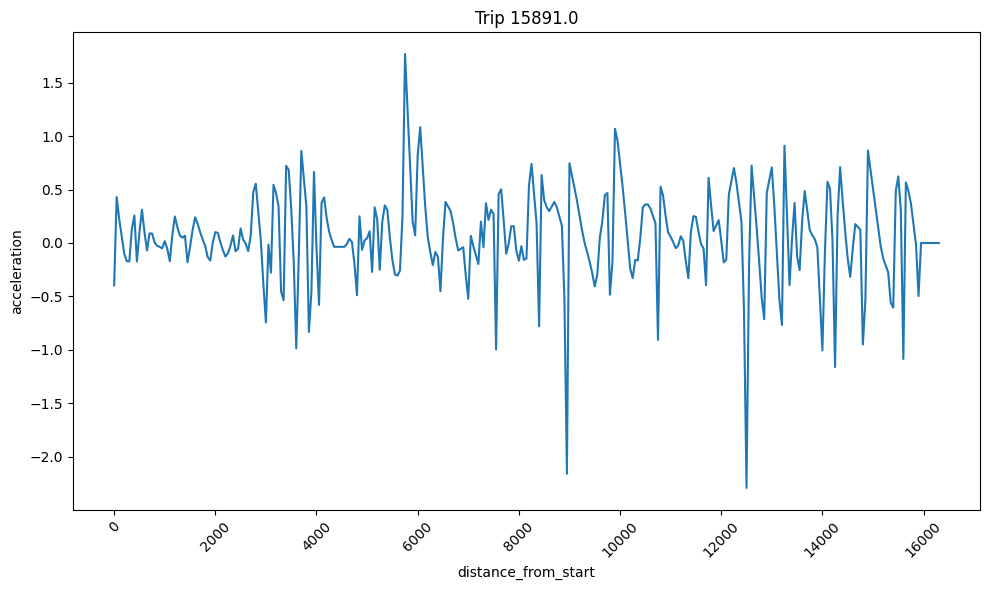

In [19]:
columnx='distance_from_start'
columny='acceleration'

trip_df = interpolated_dataframes[1]
plt.figure(figsize=(10, 6))  # Adjust figure size as needed
plt.plot(trip_df[f"{columnx}"], trip_df[f"{columny}"])
plt.xlabel(f"{columnx}")
plt.ylabel(f"{columny}")
plt.title("Trip " + str(trip_id))
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.tight_layout()  # Adjust layout for better formatting
plt.show()

In [20]:
# get the number of columns in dataframes_without_trip_id
num_columns = len(interpolated_dataframes[0].columns)
num_columns

7

In [21]:
# get a list of column names in interpolated_dataframes
column_namesInter = interpolated_dataframes[1].columns
#make it to a string list of names 
column_namesInter = column_namesInter.tolist()
column_namesInter

['distance_from_start',
 'radial_acceleration',
 'speed',
 'acceleration',
 'acceleration_der',
 'bus_stop',
 'segment']

# Clustering

In [22]:
Dict_of_clusters = {}

# Normal Cluster

In [23]:
features_only_df = data_to_cluster[['speed', 'acceleration', 'radial_acceleration','acceleration_der']]

In [24]:
# from sklearn.cluster import KMeans
# import matplotlib.pyplot as plt

# # Assuming you have your preprocessed data in 'data_to_cluster_mean'

# # List to store distortion values
# distortions = []

# # Choose a range of cluster counts to try
# cluster_range = range(1, 11)

# # Calculate distortion for each cluster count
# for num_clusters in cluster_range:
#     kmeans = KMeans(n_clusters=num_clusters, random_state=0)
#     kmeans.fit(data_to_cluster_mean)
#     distortions.append(kmeans.inertia_)  # Inertia is the sum of squared distances to the nearest cluster center

# # Plot the elbow curve
# plt.plot(cluster_range, distortions, marker='o')
# plt.xlabel('Number of Clusters')
# plt.ylabel('Distortion')
# plt.title('Elbow Method')
# plt.show()

In [25]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Choose the number of clusters
num_clusters = 4

# Initialize the clustering algorithm
kmeans = KMeans(n_clusters=num_clusters, random_state=0)

# Fit the algorithm to your data
kmeans.fit(features_only_df)

# Get cluster assignments for each data point
cluster_labels = kmeans.labels_

# Get cluster centers (centroids)
cluster_centers = kmeans.cluster_centers_

# Add cluster labels to your original dataset
data_with_clusters = pd.DataFrame(features_only_df, columns=['speed', 'acceleration', 'radial_acceleration','acceleration_der'])
data_with_clusters['cluster'] = cluster_labels
data_with_clusters['deviceid'] = data_to_cluster['deviceid']  # Add 'deviceid' column from data_to_cluster
data_with_clusters['trip_id'] = data_to_cluster['trip_id']  
data_with_clusters['segment'] = data_to_cluster['segment']

c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [26]:
Norm_clusters_data=data_with_clusters.copy()
import statistics

# Define a custom function to calculate the mode
def select_mode(x):
    if len(x) == 0:
        return None
    elif len(x) == 1:
        return x.iloc[0]  # Return the single mode if there's only one
    else:
        # If there are multiple modes, return one of them
        return statistics.mode(x)

# Apply the custom mode function when aggregating
Norm_clusters_data = Norm_clusters_data.groupby(['trip_id', 'deviceid']).agg({
    'speed': 'mean',
    'acceleration': 'mean',
    'radial_acceleration': 'mean',
    'acceleration_der': 'mean',
    'cluster': select_mode  # Use the custom function to calculate the mode
}).reset_index()

Norm_clusters_vs_tid=Norm_clusters_data[['trip_id','cluster']]
# rename cluster as norm_cluster
Norm_clusters_vs_tid.rename(columns={'cluster':'norm_cluster'}, inplace=True)

C:\Users\gw\AppData\Local\Temp\ipykernel_39440\2330066521.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Norm_clusters_vs_tid.rename(columns={'cluster':'norm_cluster'}, inplace=True)


In [27]:
# cluster average segment vise

seg_cluster=data_with_clusters.copy()
import statistics

# Define a custom function to calculate the mode
def select_mode(x):
    if len(x) == 0:
        return None
    elif len(x) == 1:
        return x.iloc[0]  # Return the single mode if there's only one
    else:
        # If there are multiple modes, return one of them
        return statistics.mode(x)

# Apply the custom mode function when aggregating
seg_cluster = seg_cluster.groupby(['trip_id', 'deviceid','segment']).agg({
    'speed': 'mean',
    'acceleration': 'mean',
    'radial_acceleration': 'mean',
    'acceleration_der': 'mean',
    'cluster': select_mode  # Use the custom function to calculate the mode
}).reset_index()

seg_cluster_vs_tid=seg_cluster[['trip_id','segment','cluster']]
# rename cluster as norm_cluster
seg_cluster_vs_tid.rename(columns={'cluster':'norm_cluster'}, inplace=True)

C:\Users\gw\AppData\Local\Temp\ipykernel_39440\4088580251.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  seg_cluster_vs_tid.rename(columns={'cluster':'norm_cluster'}, inplace=True)


In [28]:
seg_cluster_vs_tid

,trip_id,segment,norm_cluster
0,2.0,0,0
1,2.0,1,1
2,2.0,2,2
3,2.0,3,1
4,2.0,4,1
...,...,...,...
100923,15887.0,11,3
100924,15887.0,12,3
100925,15887.0,13,3
100926,15887.0,14,3


In [29]:
# save seg_cluster_vs_tid to csv
seg_cluster_vs_tid.to_csv('../DataOut/seg_cluster_vs_tid.csv', index=False)

In [30]:
bus_running_times_feature_added_all_moddedDF=pd.read_csv('../DataOut/bus_running_times_feature_added_all_moddedDF.csv')

In [31]:
# bus_running_times_feature_added_all_with_Kmeans_cluster = pd.merge(
#     left=bus_running_times_feature_added_all_moddedDF,
#     right=bus_trip_speed_and_other_features_grpd[['trip_id', 'segment', 'Kmeans_cluster']],
#     on=['trip_id', 'segment']
# ) do a left join like this

# left join bus_running_times_feature_added_all_moddedDF with bus_trip_speed_and_other_features_grpd[['trip_id', 'segment', 'Kmeans_cluster'] on trip_id and segment
bus_running_times_feature_added_all_with_Kmeans_cluster = pd.merge(
    left=bus_running_times_feature_added_all_moddedDF,
    right=seg_cluster_vs_tid[['trip_id', 'segment', 'norm_cluster']],
    on=['trip_id', 'segment'],
    how='left'
)

bus_running_times_feature_added_all_with_Kmeans_cluster


,trip_id,deviceid,direction,segment,date,start_time,end_time,run_time,run_time_in_seconds,length,...,rt(n-3),hour_of_day,day,month,temp,precip,windspeed,conditions,dt(n-1),norm_cluster
0,4890.0,262.0,1.0,1.0,2021-10-01,06:39:49,06:40:58,0 days 00:01:09,69.0,0.6261,...,96.0,6.0,1.0,10.0,20.0,0.0,6.1,Partially cloudy,0.0,1.0
1,4890.0,262.0,1.0,2.0,2021-10-01,06:42:12,06:45:42,0 days 00:03:30,210.0,1.2808,...,247.0,6.0,1.0,10.0,20.0,0.0,6.1,Partially cloudy,74.0,2.0
2,4890.0,262.0,1.0,3.0,2021-10-01,06:45:42,06:53:58,0 days 00:08:16,496.0,2.1125,...,506.0,6.0,1.0,10.0,20.0,0.0,6.1,Partially cloudy,0.0,2.0
3,4890.0,262.0,1.0,4.0,2021-10-01,06:54:04,06:57:19,0 days 00:03:15,195.0,1.5513,...,69.0,6.0,1.0,10.0,20.0,0.0,6.1,Partially cloudy,6.0,1.0
4,4890.0,262.0,1.0,5.0,2021-10-01,06:57:19,06:58:56,0 days 00:01:37,97.0,0.8450,...,210.0,6.0,1.0,10.0,20.0,0.0,6.1,Partially cloudy,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
197627,3462.0,123.0,2.0,28.0,2022-10-31,18:45:44,18:47:23,0:01:39,99.0,0.8700,...,197.0,18.0,31.0,10.0,22.2,0.0,4.3,Partially cloudy,9.0,NaN
197628,3462.0,123.0,2.0,29.0,2022-10-31,18:47:38,18:50:23,0:02:45,165.0,1.4000,...,156.0,18.0,31.0,10.0,22.2,0.0,4.3,Partially cloudy,15.0,NaN
197629,3462.0,123.0,2.0,30.0,2022-10-31,18:50:56,18:56:33,0:05:37,337.0,2.5600,...,63.0,18.0,31.0,10.0,22.2,0.0,4.3,Partially cloudy,33.0,NaN
197630,3462.0,123.0,2.0,31.0,2022-10-31,18:56:48,18:57:34,0:00:46,46.0,0.4200,...,99.0,18.0,31.0,10.0,22.2,0.0,4.3,Partially cloudy,15.0,NaN


In [32]:
bus_running_times_feature_added_all_with_Kmeans_cluster=bus_running_times_feature_added_all_with_Kmeans_cluster[bus_running_times_feature_added_all_with_Kmeans_cluster['direction']==1]
bus_running_times_feature_added_all_with_Kmeans_cluster.dropna(inplace=True)
bus_running_times_feature_added_all_with_Kmeans_cluster

C:\Users\gw\AppData\Local\Temp\ipykernel_39440\2222551562.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  bus_running_times_feature_added_all_with_Kmeans_cluster.dropna(inplace=True)


,trip_id,deviceid,direction,segment,date,start_time,end_time,run_time,run_time_in_seconds,length,...,rt(n-3),hour_of_day,day,month,temp,precip,windspeed,conditions,dt(n-1),norm_cluster
0,4890.0,262.0,1.0,1.0,2021-10-01,06:39:49,06:40:58,0 days 00:01:09,69.0,0.6261,...,96.0,6.0,1.0,10.0,20.0,0.0,6.1,Partially cloudy,0.0,1.0
1,4890.0,262.0,1.0,2.0,2021-10-01,06:42:12,06:45:42,0 days 00:03:30,210.0,1.2808,...,247.0,6.0,1.0,10.0,20.0,0.0,6.1,Partially cloudy,74.0,2.0
2,4890.0,262.0,1.0,3.0,2021-10-01,06:45:42,06:53:58,0 days 00:08:16,496.0,2.1125,...,506.0,6.0,1.0,10.0,20.0,0.0,6.1,Partially cloudy,0.0,2.0
3,4890.0,262.0,1.0,4.0,2021-10-01,06:54:04,06:57:19,0 days 00:03:15,195.0,1.5513,...,69.0,6.0,1.0,10.0,20.0,0.0,6.1,Partially cloudy,6.0,1.0
4,4890.0,262.0,1.0,5.0,2021-10-01,06:57:19,06:58:56,0 days 00:01:37,97.0,0.8450,...,210.0,6.0,1.0,10.0,20.0,0.0,6.1,Partially cloudy,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168830,11205.0,513.0,1.0,11.0,2022-10-31,18:38:46,18:41:11,0:02:25,145.0,1.1000,...,84.0,18.0,31.0,10.0,22.2,0.0,4.3,Partially cloudy,15.0,3.0
168831,11205.0,513.0,1.0,12.0,2022-10-31,18:41:11,18:43:37,0:02:26,146.0,1.3100,...,34.0,18.0,31.0,10.0,22.2,0.0,4.3,Partially cloudy,0.0,3.0
168832,11205.0,513.0,1.0,13.0,2022-10-31,18:43:44,18:46:13,0:02:29,149.0,1.1500,...,191.0,18.0,31.0,10.0,22.2,0.0,4.3,Partially cloudy,7.0,2.0
168833,11205.0,513.0,1.0,14.0,2022-10-31,18:46:28,18:47:48,0:01:20,80.0,0.8900,...,145.0,18.0,31.0,10.0,22.2,0.0,4.3,Partially cloudy,15.0,3.0


In [33]:
Norm_clusters_data

,trip_id,deviceid,speed,acceleration,radial_acceleration,acceleration_der,cluster
0,2.0,116,9.706123,-0.028592,0.483827,-0.004051,1
1,4.0,116,8.245167,-0.024723,0.401335,-0.002940,1
2,6.0,116,8.495174,-0.028923,0.421818,-0.004400,1
3,8.0,116,9.572668,-0.033368,0.526471,-0.005680,1
4,10.0,116,9.485664,-0.060823,0.470724,-0.010615,1
...,...,...,...,...,...,...,...
6396,15707.0,1718,11.942057,-0.059517,1.699724,-0.042881,1
6397,15729.0,1718,10.854053,-0.042150,1.331444,-0.030289,1
6398,15759.0,1718,11.802070,-0.058992,1.390070,-0.036605,1
6399,15870.0,1719,11.607757,-0.045144,2.009297,-0.072283,1


In [34]:
# number of each clusetrs in Norm_clusters_vs_tid
seg_cluster_vs_tid['norm_cluster'].value_counts()

norm_cluster
1    46110
3    25476
2    25284
0     4058
Name: count, dtype: int64

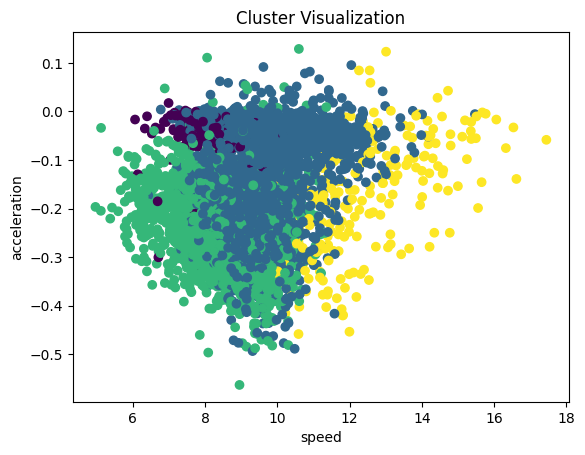

In [35]:
def draw_tid_clusters(data_with_clusters, x_axis, y_axis, cluster_labels, cluster_centers=None):
    # Visualize the clusters (for 2D data)
    plt.scatter(data_with_clusters[x_axis], data_with_clusters[y_axis], c=cluster_labels, cmap='viridis')
    if cluster_centers is not None:
        plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], marker='X', s=100, c='red')
    plt.xlabel(x_axis)
    plt.ylabel(y_axis)
    plt.title('Cluster Visualization')
    plt.show()

# Make sure 'tid_cluster' is a list or 1D array
tid_cluster = Norm_clusters_data['cluster'].tolist()


# Now, call the draw_clusters function
draw_tid_clusters(Norm_clusters_data, 'speed', 'acceleration', tid_cluster)


In [36]:
Dict_of_clusters['norm_cluster']=Norm_clusters_data

In [37]:
def draw_clusters(data_with_clusters,x_axis,y_axis):
    # Visualize the clusters (for 2D data)
    plt.scatter(data_with_clusters[x_axis], data_with_clusters[y_axis], c=cluster_labels, cmap='viridis')
    plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], marker='X', s=100, c='red')
    plt.xlabel(x_axis)
    plt.ylabel(y_axis)
    plt.title('Cluster Visualization')
    plt.show()


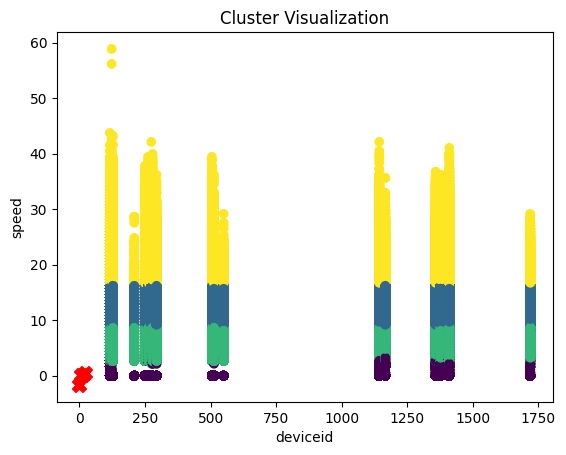

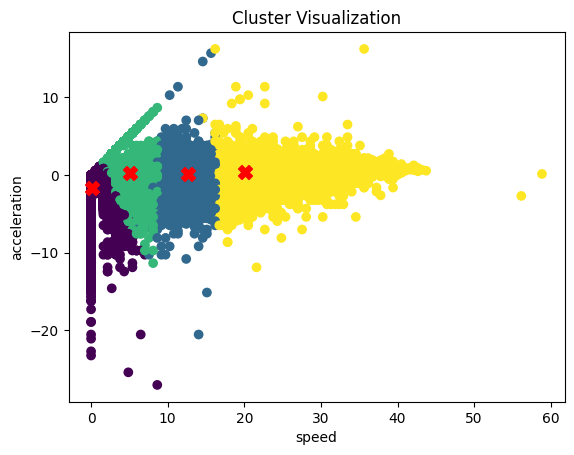

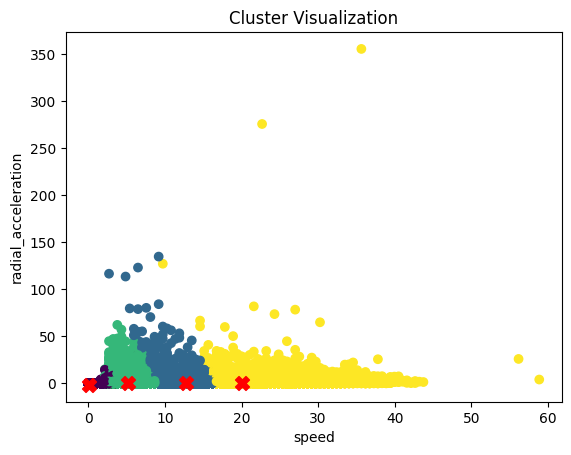

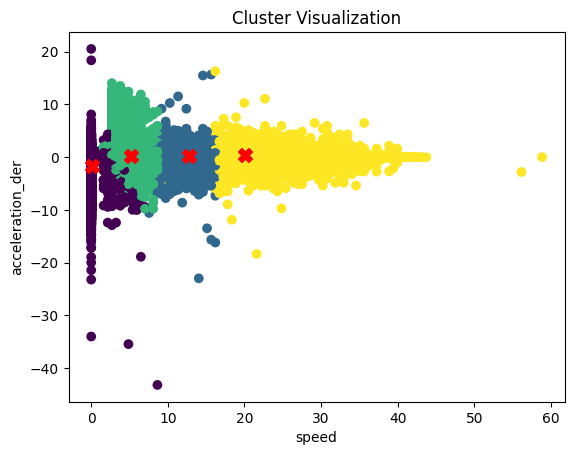

In [38]:
draw_clusters(data_with_clusters,'deviceid','speed')
draw_clusters(data_with_clusters,'speed','acceleration')
draw_clusters(data_with_clusters,'speed','radial_acceleration')
draw_clusters(data_with_clusters,'speed','acceleration_der')

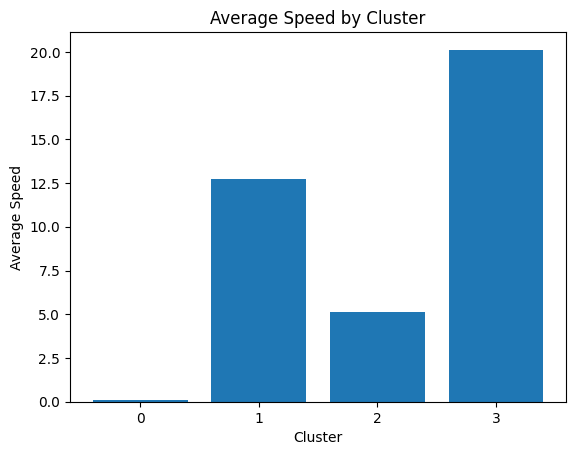

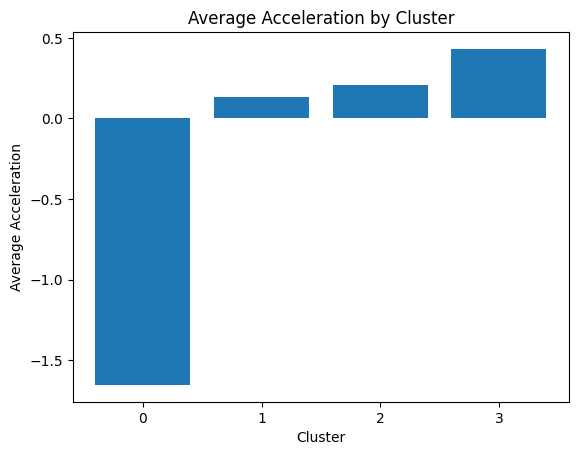

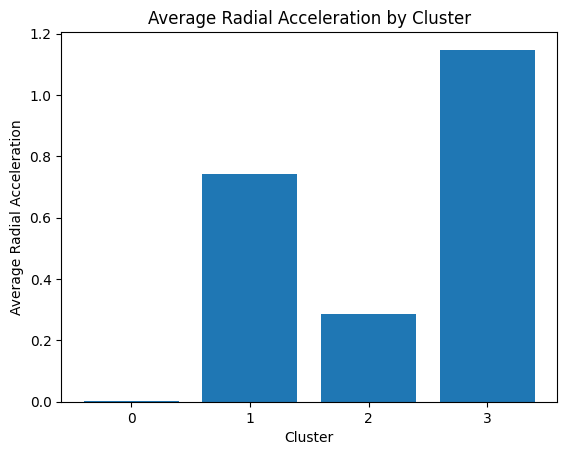

In [39]:
import matplotlib.pyplot as plt

# Calculate average values for each cluster
average_values = data_with_clusters.groupby('cluster').mean()

# Plot bar graph for Average Speed
plt.bar(average_values.index, average_values['speed'])
plt.xlabel('Cluster')
plt.ylabel('Average Speed')
plt.title('Average Speed by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Acceleration
plt.bar(average_values.index, average_values['acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Acceleration')
plt.title('Average Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Radial Acceleration
plt.bar(average_values.index, average_values['radial_acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Radial Acceleration')
plt.title('Average Radial Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()
